In [48]:
from NN_Run import L_layer_model
from NN_Helper import L_model_forward
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import tkinter as tk
import tkinter.filedialog as fd

In [49]:
#filename = askopenfilename() # Browse for file
root = tk.Tk()
filez = fd.askopenfilenames(parent=root, title='Choose files')

In [50]:
X = pd.DataFrame()
Y = pd.DataFrame()
for value in iter(filez):
    df = pd.read_csv(value) # Store data in file
    X_read = df[:-1]
    Y_read = pd.DataFrame(np.array([df["GLUCOSE CONC"][1:], 
                           df["GLUTAMINE CONC"][1:], 
                           df["AMMONIA CONC"][1:], 
                           df["INHIBITOR SAT"][1:], 
                           df["TOTAL CELL DENSITY"][1:], 
                           df["VIABLE CELL DENSITY"][1:], 
                           df["DEAD CELL DENSITY"][1:], 
                           df["INHIBITOR SAT"][1:]]).T)
    X = pd.concat([X,X_read], ignore_index=True)
    Y = pd.concat([Y,Y_read], ignore_index=True)

idx = np.random.permutation(X.index)
def df_reindex(df1,idx):
    df1_temp = df1
    return df1_temp.reindex(idx)

X_randomized = df_reindex(X,idx)
Y_randomized = df_reindex(Y,idx)
print(X_randomized.shape)
print(Y_randomized.shape)

(33449, 30)
(33449, 8)


In [51]:
def normalize_mat(mat0):
    m = mat0[0].shape[0]
    def inner_f(mat,acc):
        for array in iter(mat):
            temp_mat = acc
            sig = (1/m)*np.sum(np.square(array))
            mean = (1/m)*np.sum(array)
            remove_mean = array - mean
            normalized_array = remove_mean / (sig + 10**-10)
            temp_mat.append(normalized_array)
            acc = temp_mat   
        return acc
    return np.array(inner_f(mat0,[]))

X_norm = normalize_mat(np.array(X_randomized))
Y_norm = normalize_mat(np.array(Y_randomized))
print(X_norm.shape)
print(Y_norm.shape)

(33449, 30)
(33449, 8)


(8, 33449)
(30, 33449)
Cost after iteration 0: 0.017865


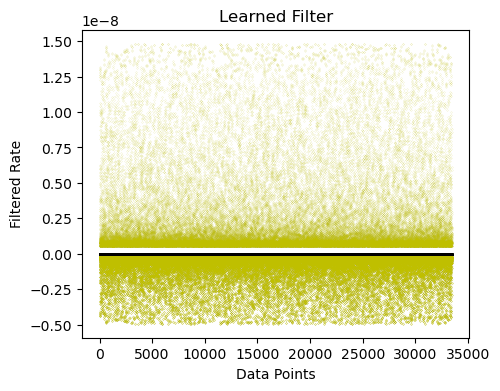

Cost after iteration 100: 0.017764


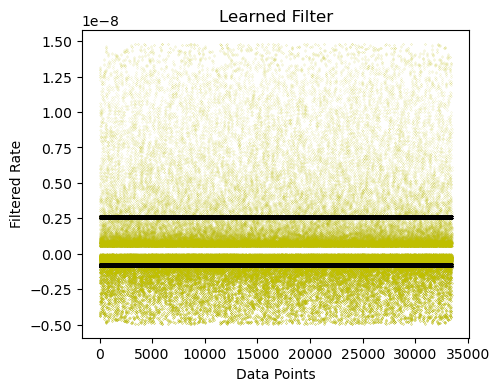

Cost after iteration 200: 0.017663


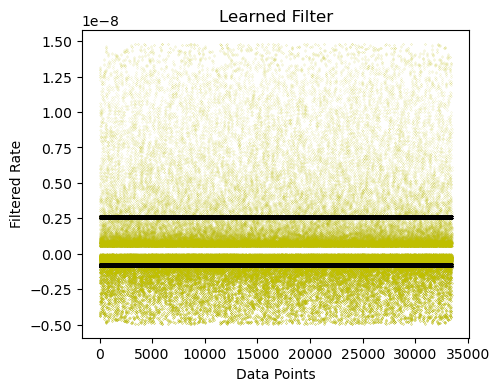

Cost after iteration 300: 0.017563


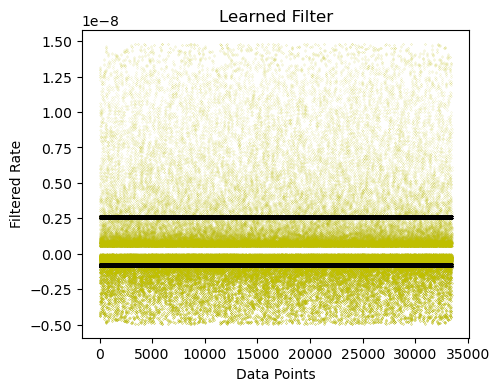

Cost after iteration 400: 0.017464


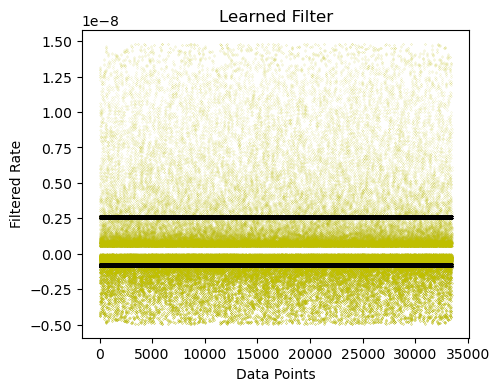

Cost after iteration 500: 0.017365


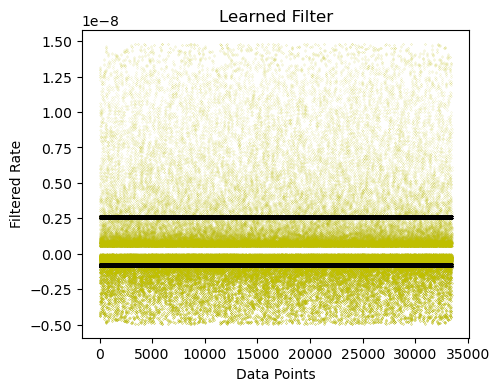

Cost after iteration 600: 0.017267


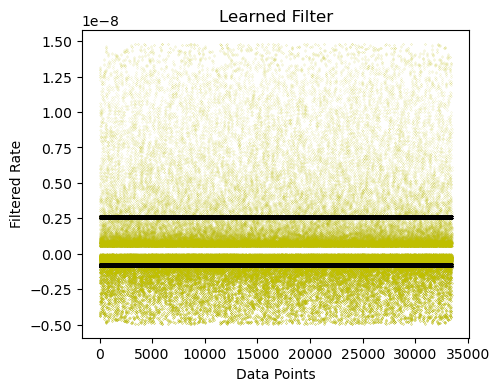

Cost after iteration 700: 0.017169


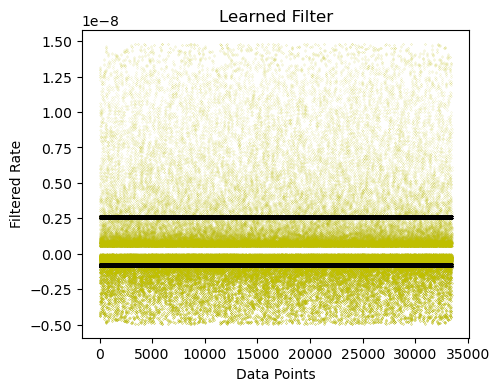

Cost after iteration 800: 0.017071


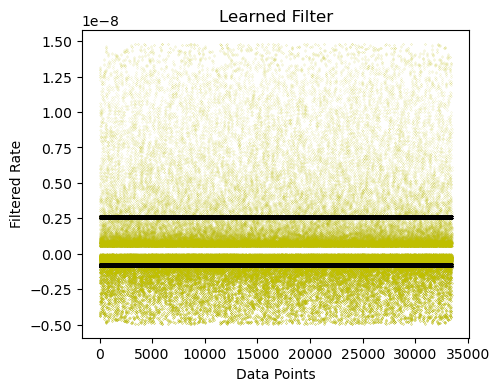

Cost after iteration 900: 0.016975


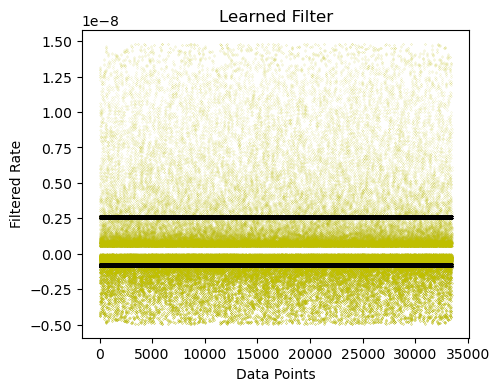

Cost after iteration 1000: 0.016879


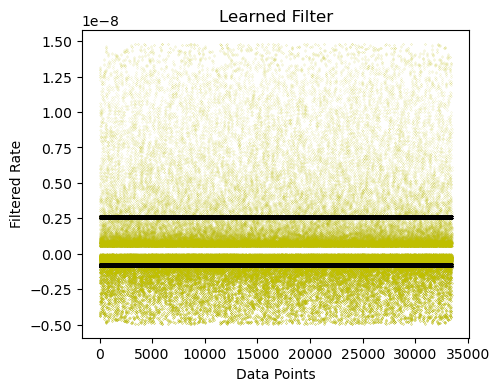

Cost after iteration 1100: 0.016783


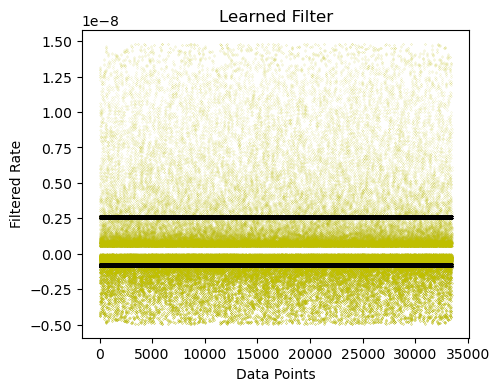

Cost after iteration 1200: 0.016688


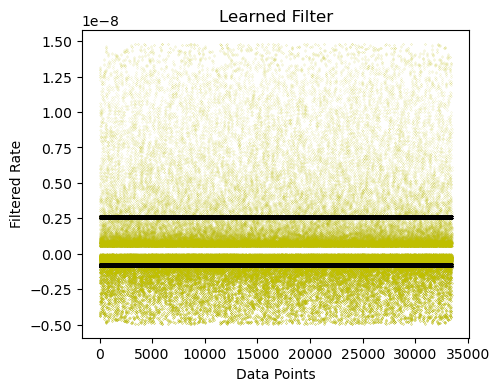

Cost after iteration 1300: 0.016593


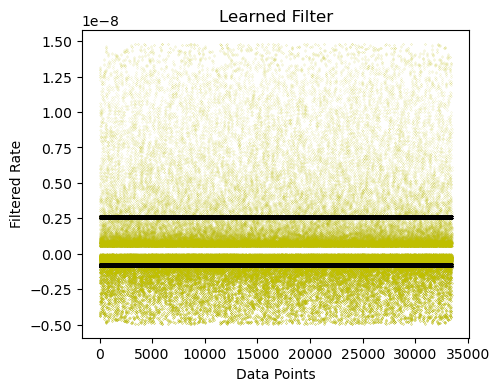

Cost after iteration 1400: 0.016499


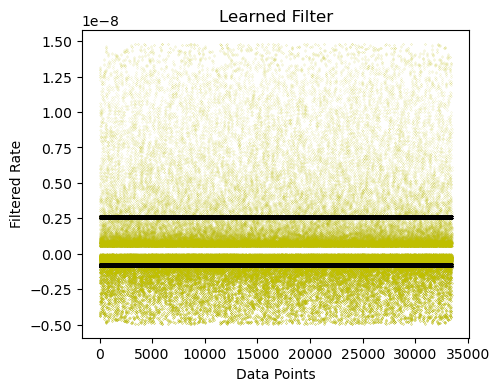

Cost after iteration 1500: 0.016406


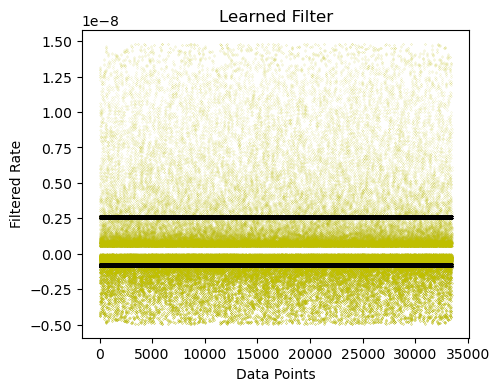

Cost after iteration 1600: 0.016313


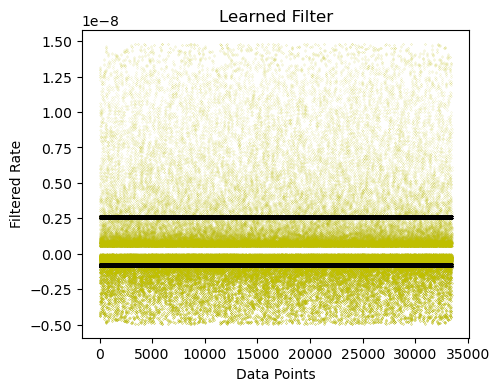

Cost after iteration 1700: 0.016221


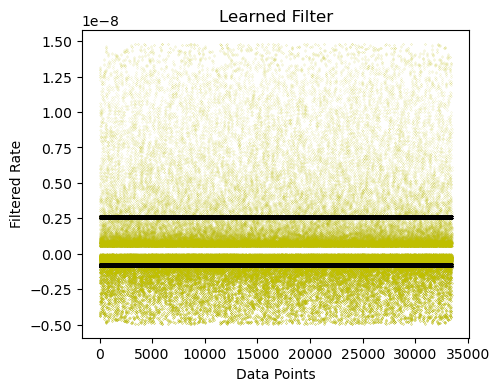

Cost after iteration 1800: 0.016129


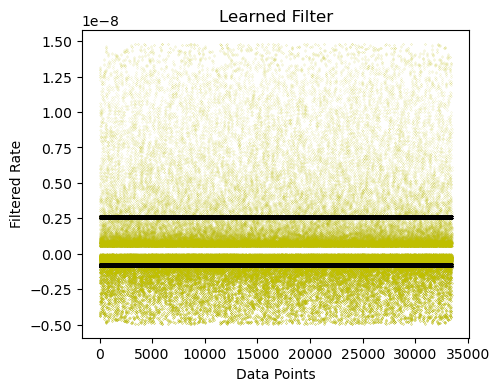

Cost after iteration 1900: 0.016037


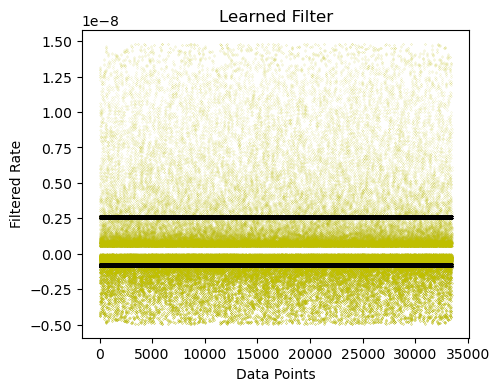

Cost after iteration 2000: 0.015947


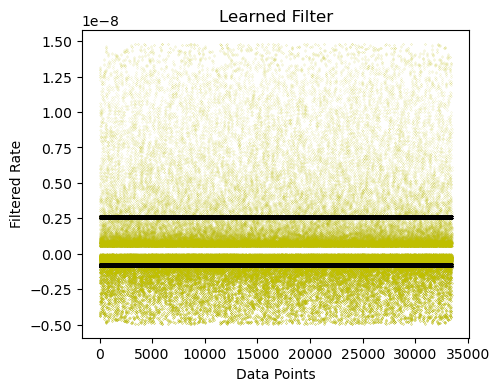

Cost after iteration 2100: 0.015856


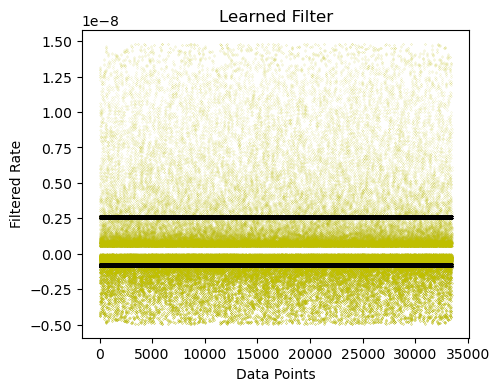

Cost after iteration 2200: 0.015766


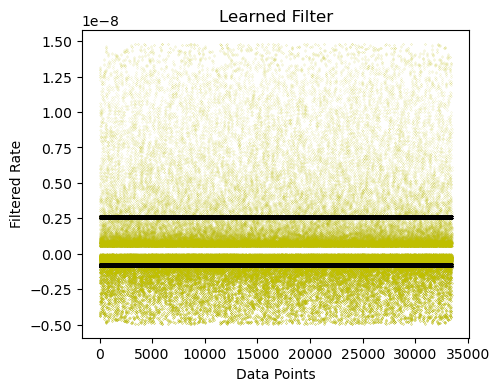

Cost after iteration 2300: 0.015677


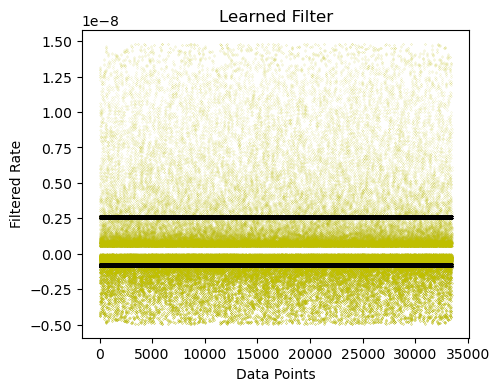

Cost after iteration 2400: 0.015588


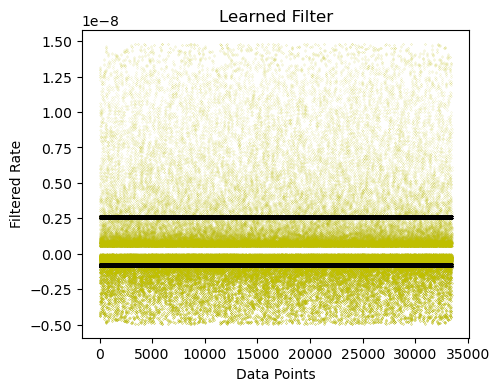

Cost after iteration 2500: 0.015500


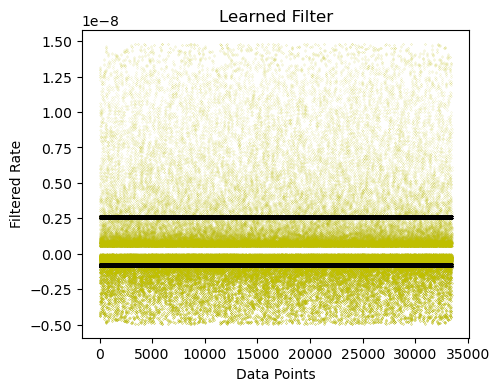

Cost after iteration 2600: 0.015412


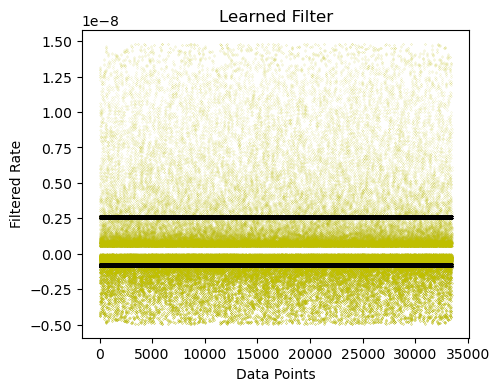

Cost after iteration 2700: 0.015325


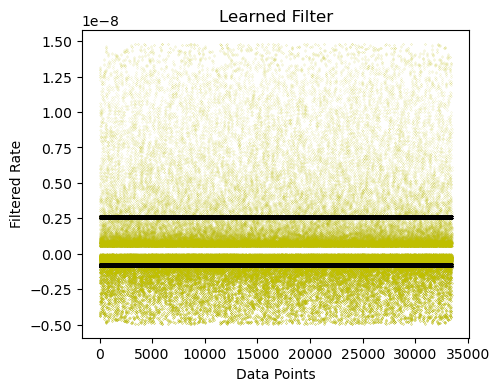

Cost after iteration 2800: 0.015238


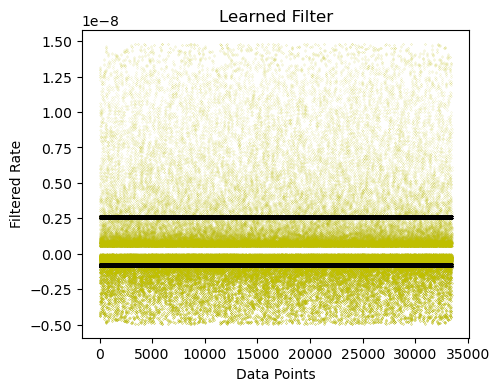

Cost after iteration 2900: 0.015152


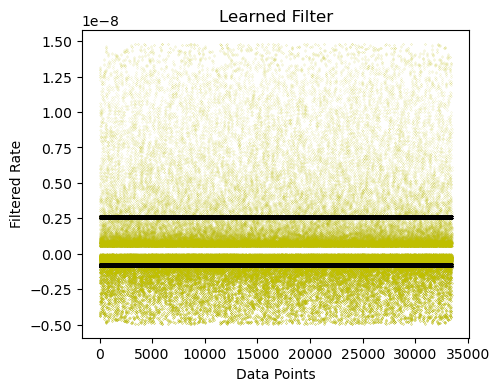

Cost after iteration 3000: 0.015066


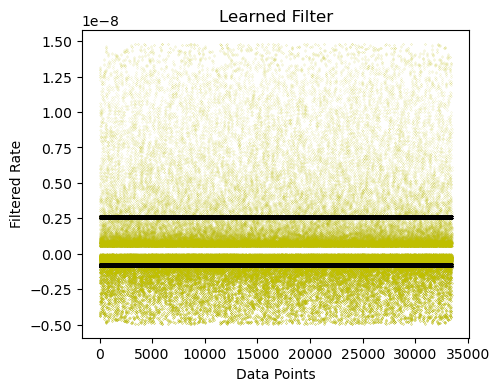

Cost after iteration 3100: 0.014981


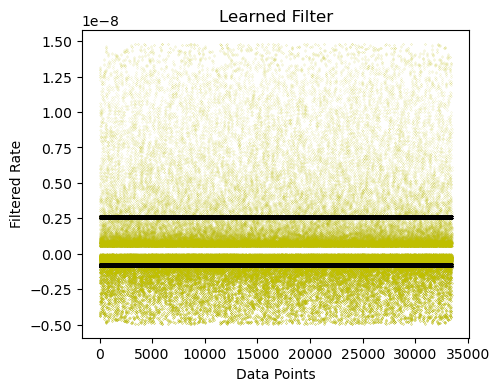

Cost after iteration 3200: 0.014896


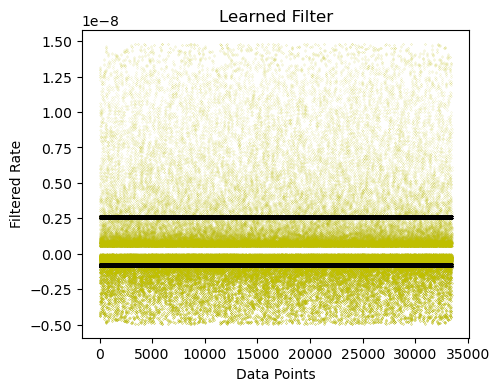

Cost after iteration 3300: 0.014811


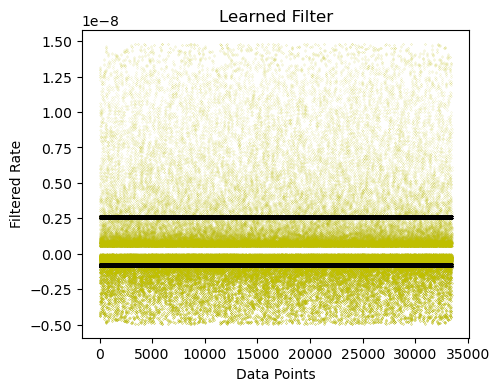

Cost after iteration 3400: 0.014728


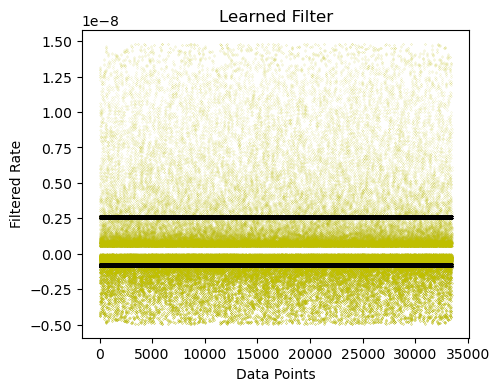

Cost after iteration 3500: 0.014644


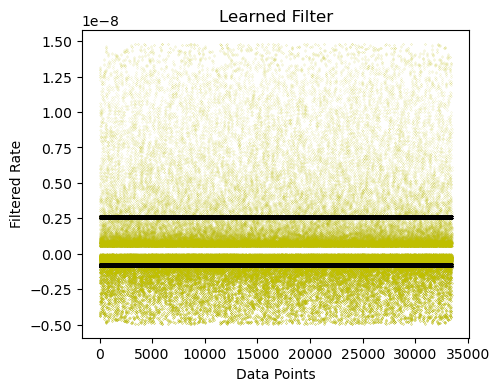

Cost after iteration 3600: 0.014561


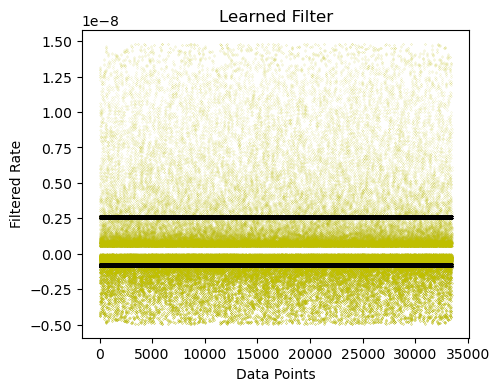

Cost after iteration 3700: 0.014479


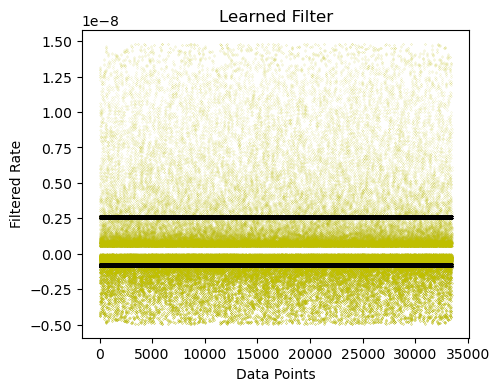

Cost after iteration 3800: 0.014397


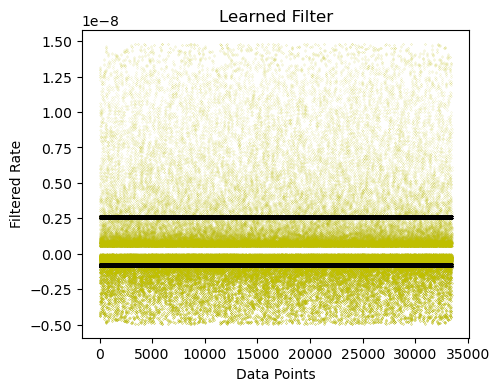

Cost after iteration 3900: 0.014315


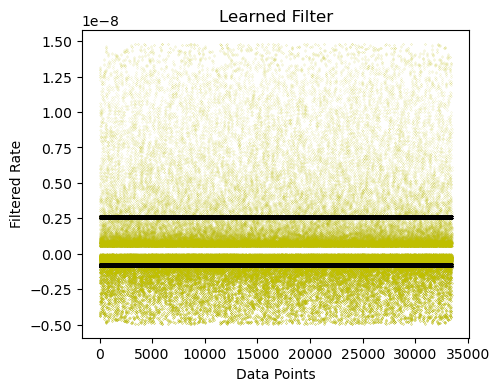

Cost after iteration 4000: 0.014234


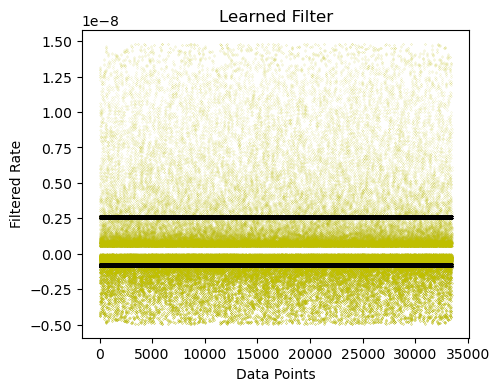

Cost after iteration 4100: 0.014153


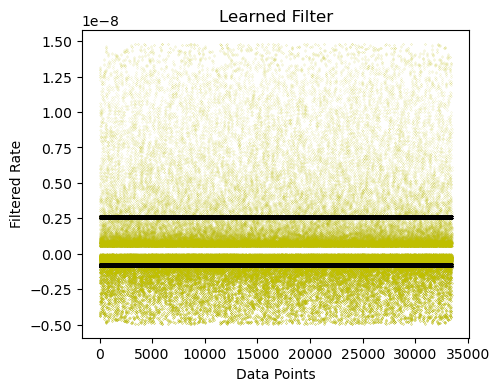

Cost after iteration 4200: 0.014073


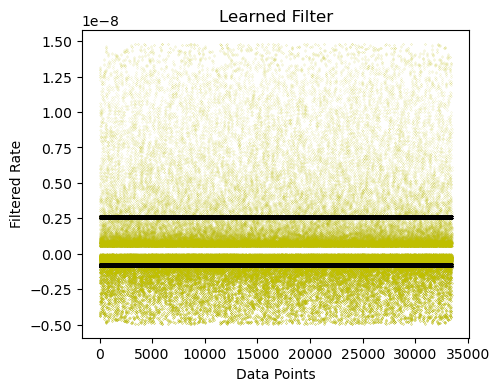

Cost after iteration 4300: 0.013994


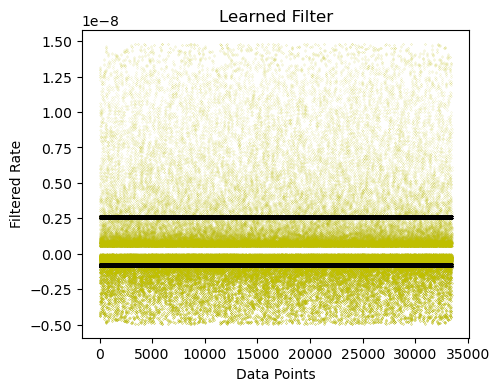

Cost after iteration 4400: 0.013914


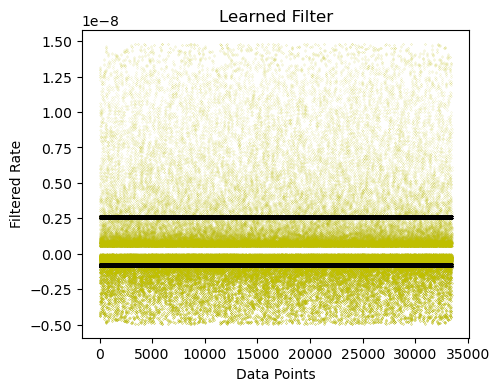

Cost after iteration 4500: 0.013835


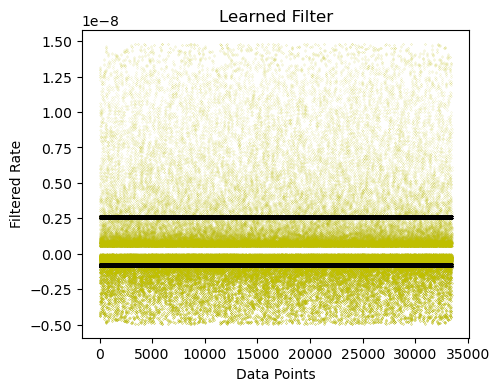

Cost after iteration 4600: 0.013757


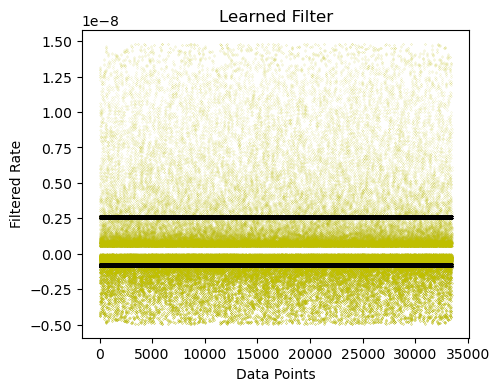

Cost after iteration 4700: 0.013679


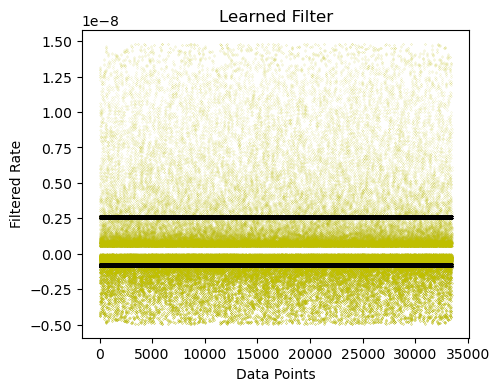

Cost after iteration 4800: 0.013602


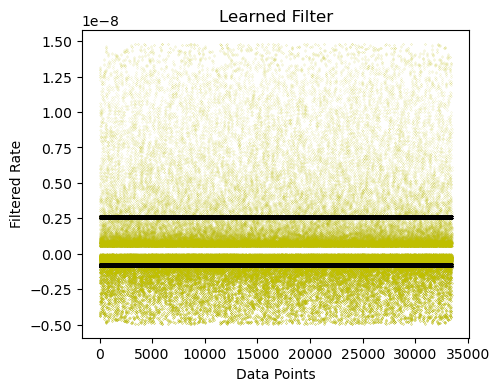

Cost after iteration 4900: 0.013525


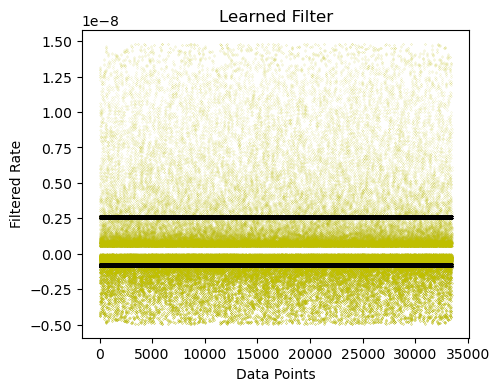

Cost after iteration 5000: 0.013448


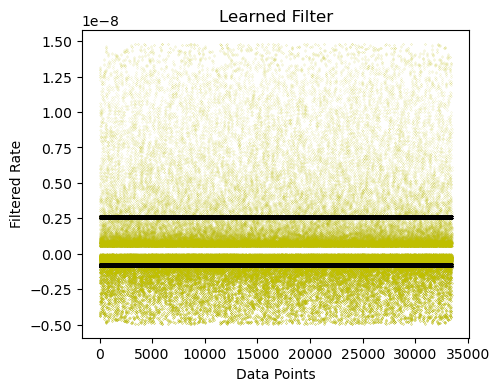

Cost after iteration 5100: 0.013372


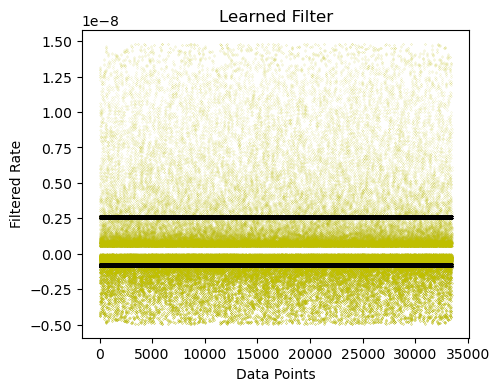

Cost after iteration 5200: 0.013296


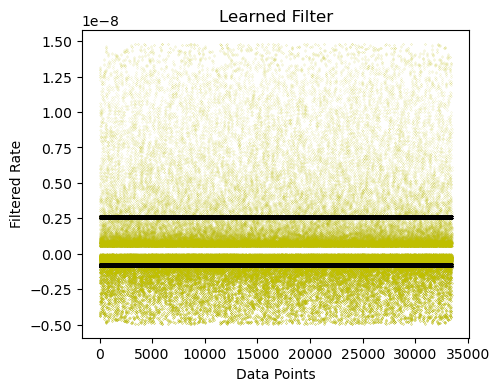

Cost after iteration 5300: 0.013221


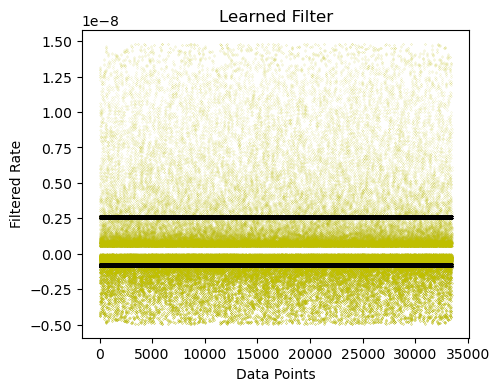

Cost after iteration 5400: 0.013146


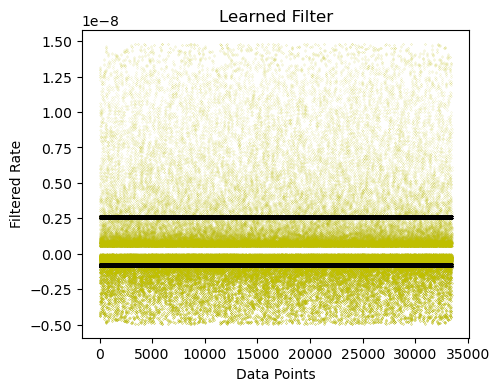

Cost after iteration 5500: 0.013071


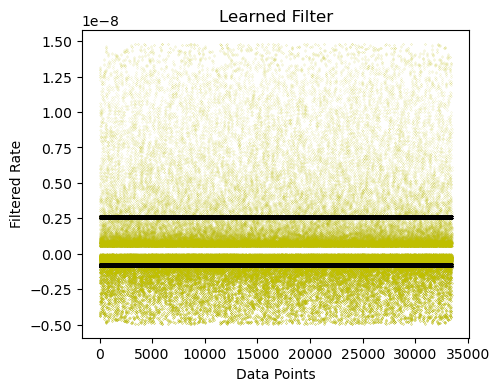

Cost after iteration 5600: 0.012997


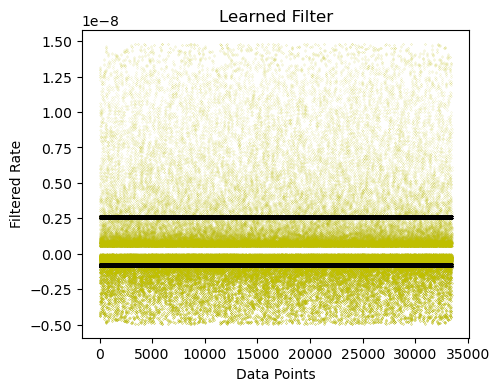

Cost after iteration 5700: 0.012924


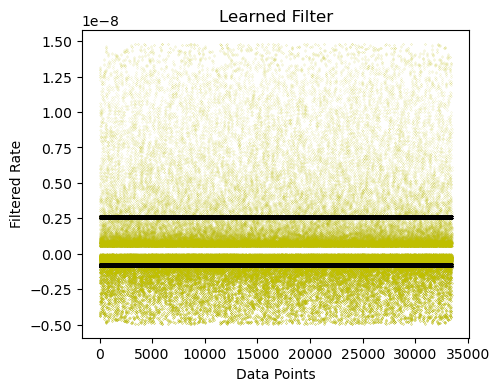

Cost after iteration 5800: 0.012851


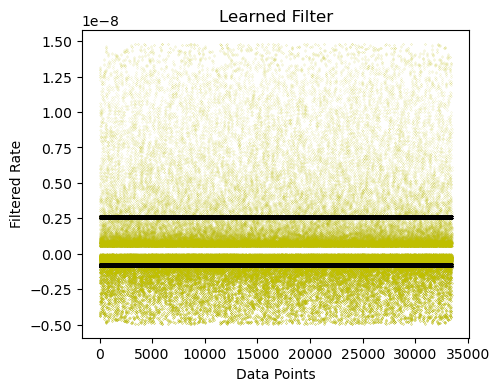

Cost after iteration 5900: 0.012778


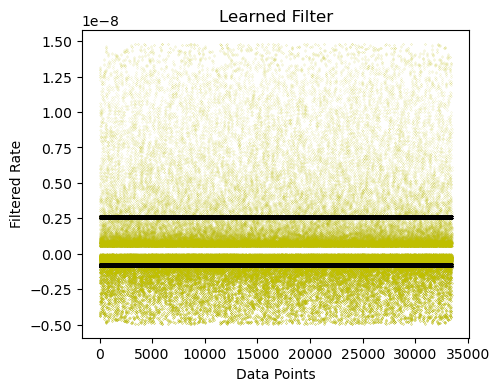

Cost after iteration 6000: 0.012705


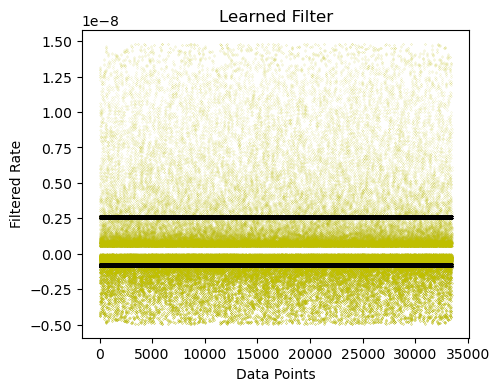

Cost after iteration 6100: 0.012633


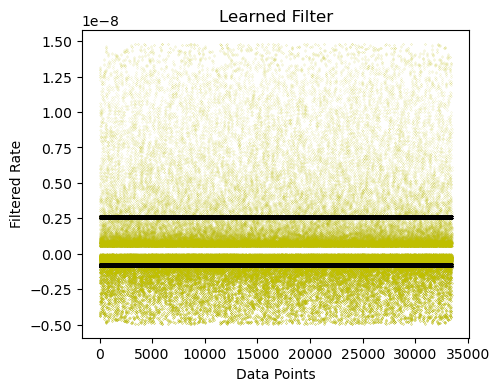

Cost after iteration 6200: 0.012562


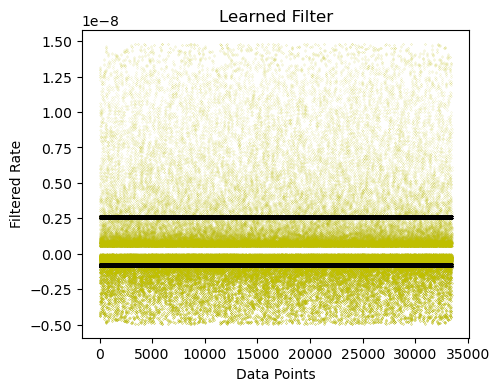

Cost after iteration 6300: 0.012491


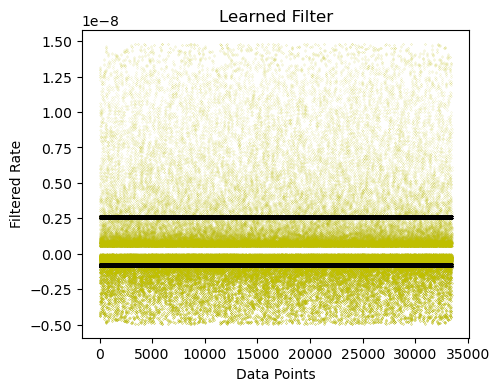

Cost after iteration 6400: 0.012420


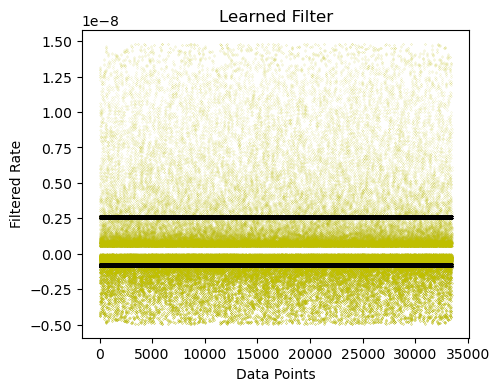

Cost after iteration 6500: 0.012350


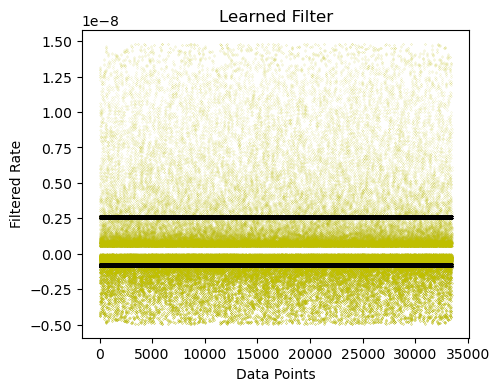

Cost after iteration 6600: 0.012280


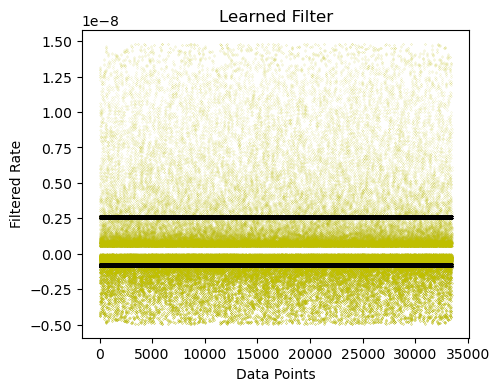

Cost after iteration 6700: 0.012210


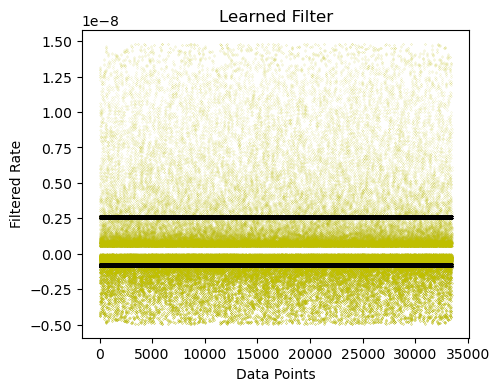

Cost after iteration 6800: 0.012141


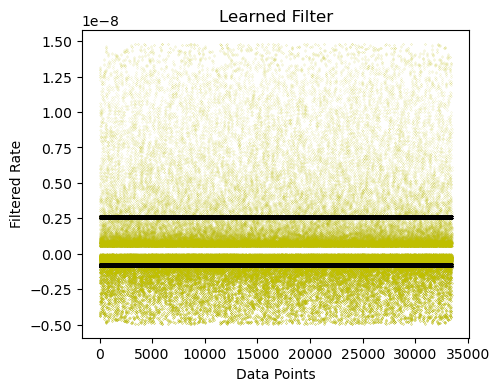

Cost after iteration 6900: 0.012072


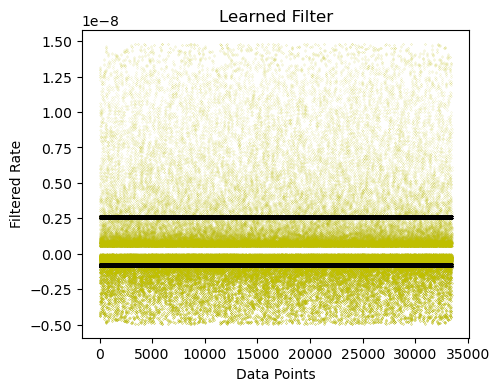

Cost after iteration 7000: 0.012004


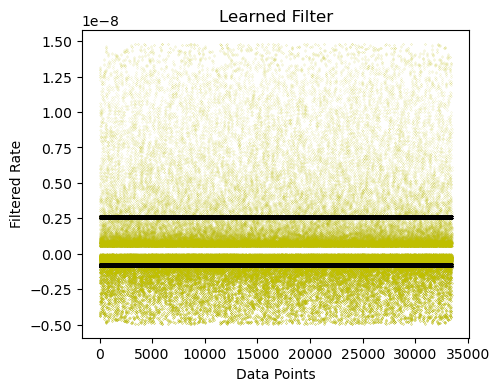

Cost after iteration 7100: 0.011936


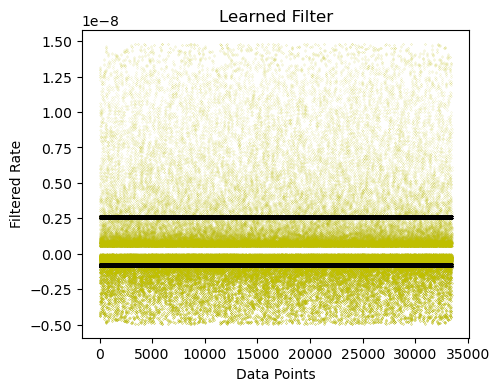

Cost after iteration 7200: 0.011868


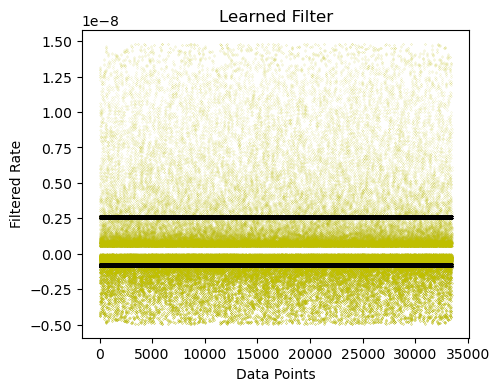

Cost after iteration 7300: 0.011801


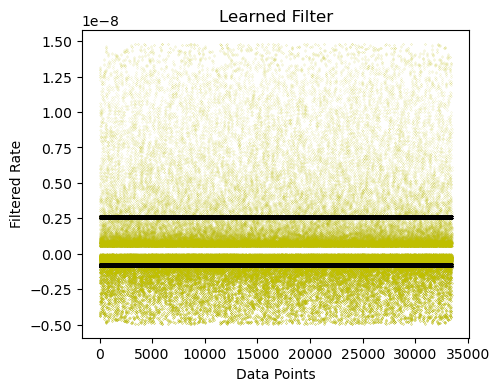

Cost after iteration 7400: 0.011734


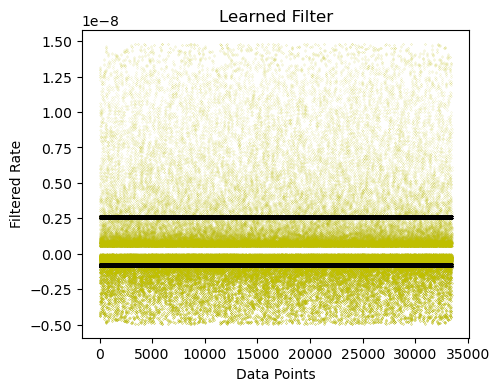

Cost after iteration 7500: 0.011668


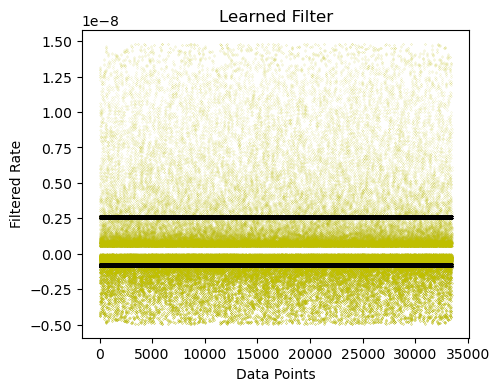

Cost after iteration 7600: 0.011602


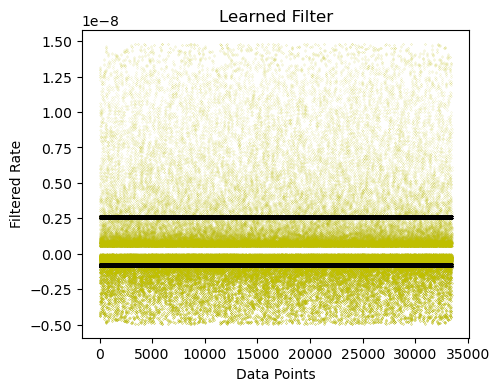

Cost after iteration 7700: 0.011536


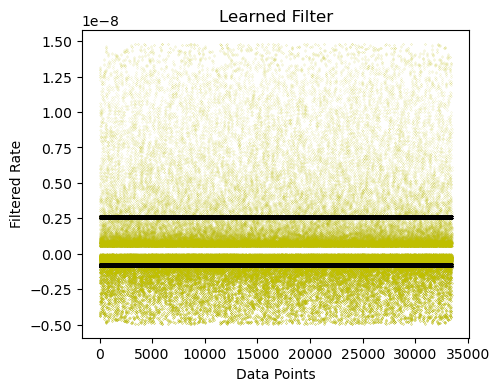

Cost after iteration 7800: 0.011471


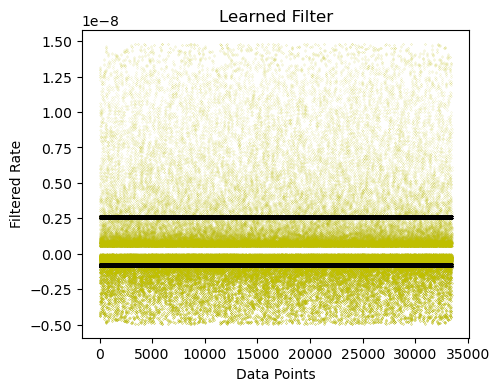

Cost after iteration 7900: 0.011406


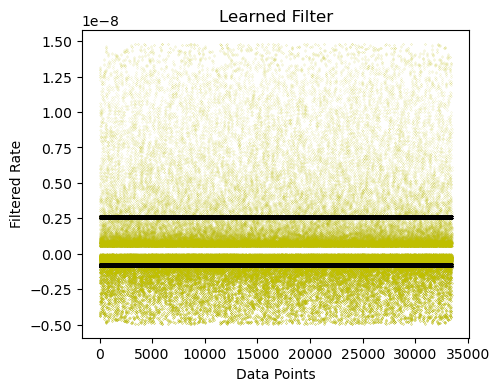

Cost after iteration 8000: 0.011341


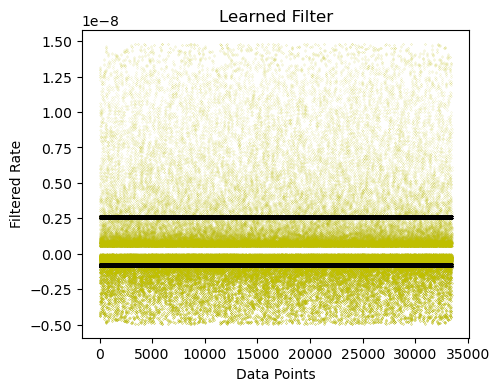

Cost after iteration 8100: 0.011277


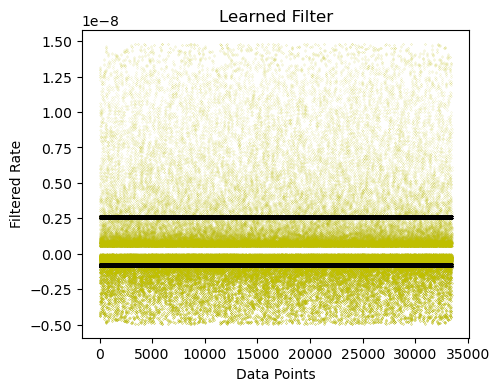

Cost after iteration 8200: 0.011213


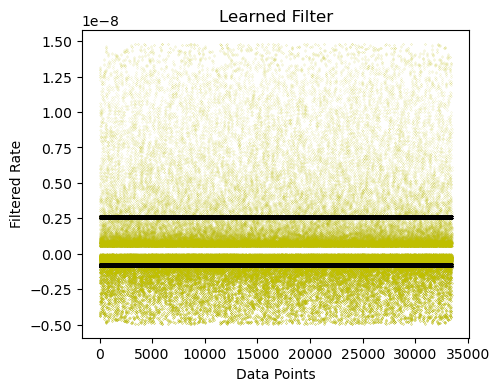

Cost after iteration 8300: 0.011149


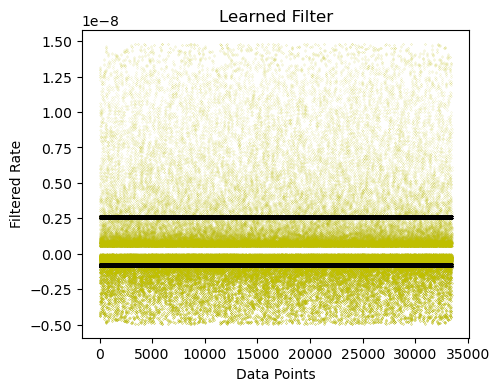

Cost after iteration 8400: 0.011086


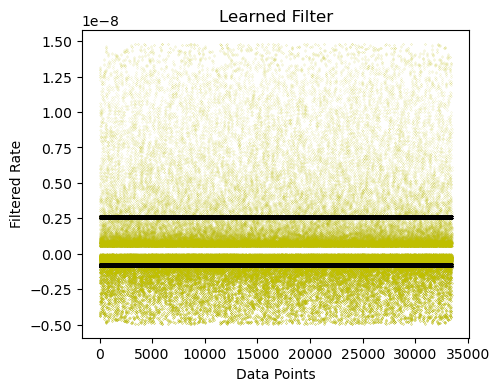

Cost after iteration 8500: 0.011023


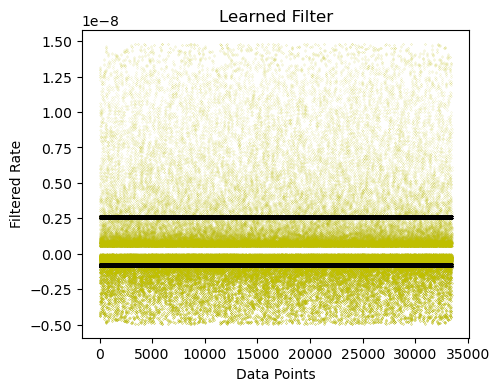

Cost after iteration 8600: 0.010961


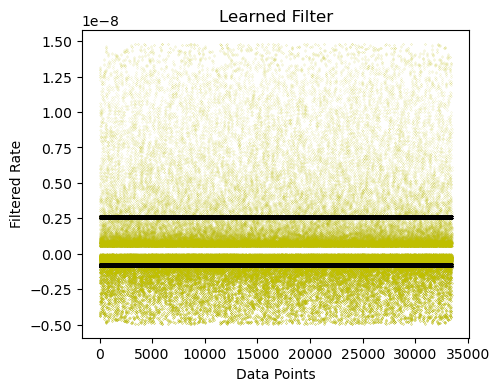

Cost after iteration 8700: 0.010899


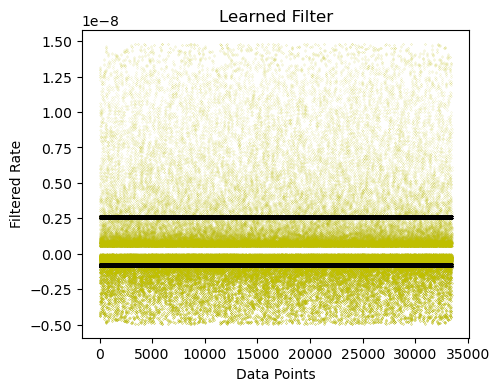

Cost after iteration 8800: 0.010837


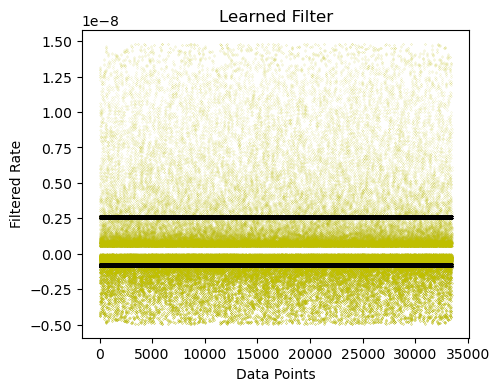

Cost after iteration 8900: 0.010776


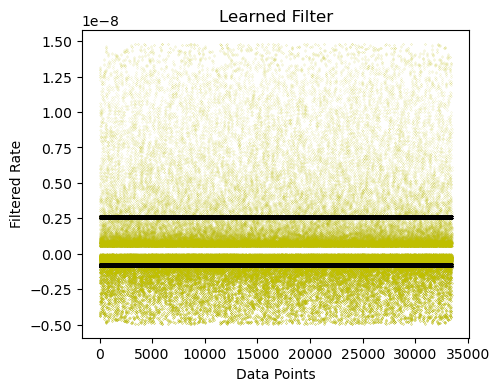

Cost after iteration 9000: 0.010715


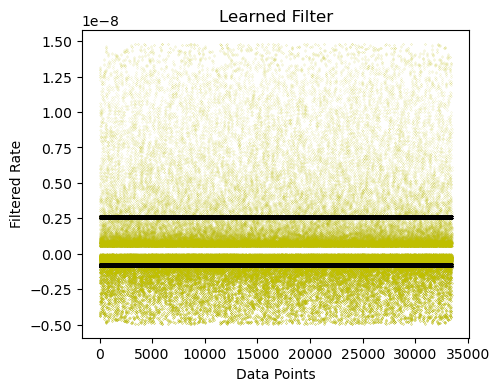

Cost after iteration 9100: 0.010654


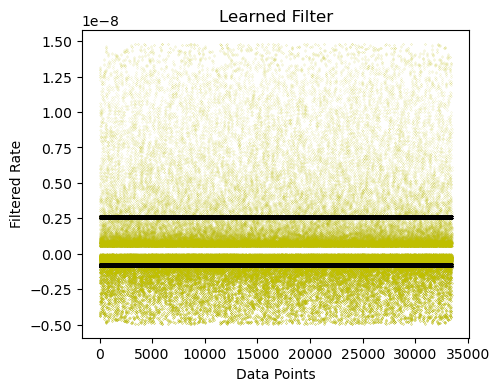

Cost after iteration 9200: 0.010594


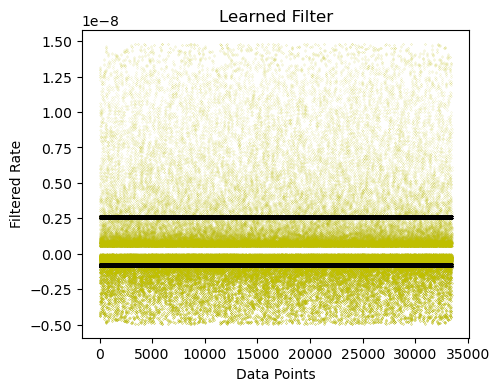

Cost after iteration 9300: 0.010534


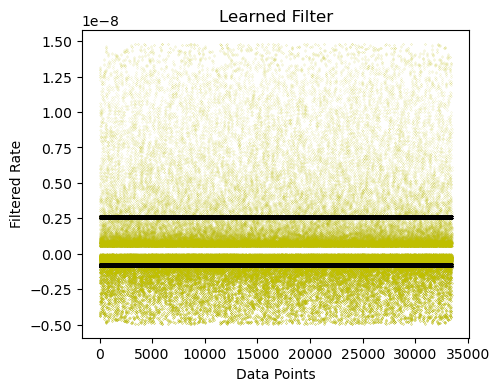

Cost after iteration 9400: 0.010474


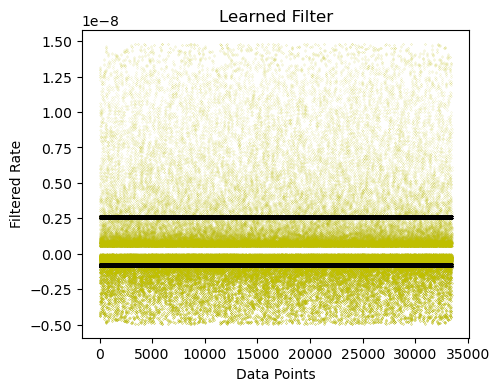

Cost after iteration 9500: 0.010415


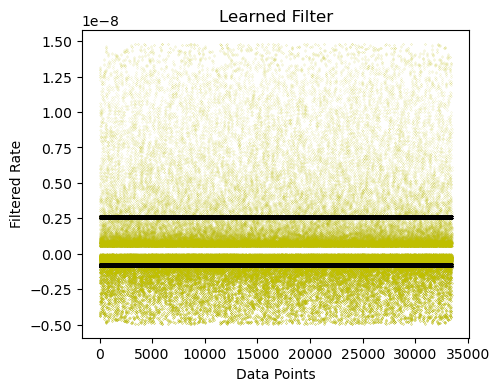

Cost after iteration 9600: 0.010356


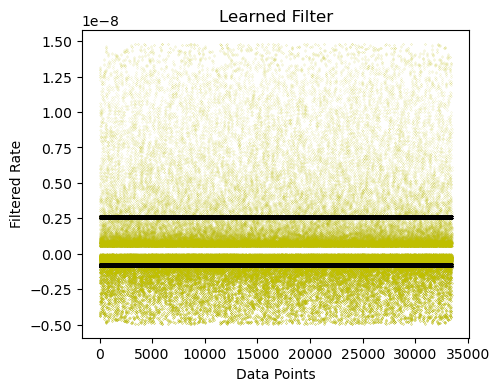

Cost after iteration 9700: 0.010297


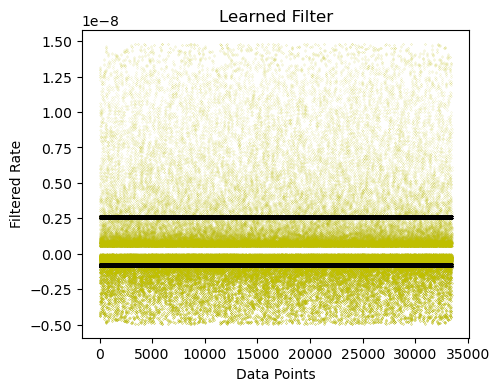

Cost after iteration 9800: 0.010239


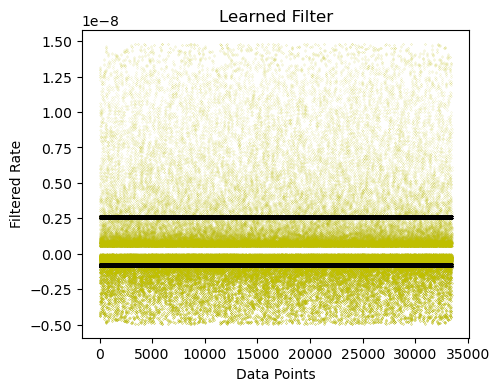

Cost after iteration 9900: 0.010181


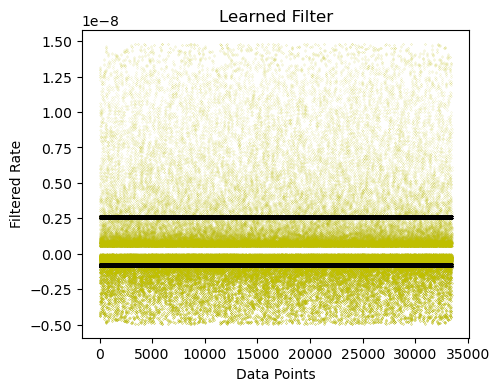

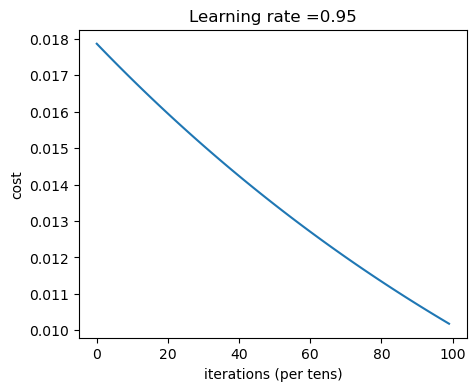

In [54]:
layers_dims = [30, 31, 50, 8] # Neural Network Layer and Node Set up

print(Y_norm.T.shape)
print(X_norm.T.shape)

[p,AL] = L_layer_model(X_norm.T, Y_norm.T, layers_dims, learning_rate = .95, num_iterations = 10000, print_cost=True, lambd = 1)
# import torch
# import torch.nn as nn
# import torch.optim as optim
# from torch.utils.data import DataLoader, TensorDataset
# from sklearn.model_selection import train_test_split

# # Convert NumPy arrays to PyTorch tensors
# X_train_numpy, X_val_numpy, y_train_numpy, y_val_numpy = train_test_split(X_norm, Y_norm, test_size=0.2, random_state=42)

# # Ensure NumPy arrays and check shapes
# X_train_numpy = np.array(X_train_numpy)
# y_train_numpy = np.array(y_train_numpy)
# print(X_train_numpy.shape)
# print(y_train_numpy.shape)
# print(X_val_numpy.shape)
# print(y_val_numpy.shape)

# # Create DataLoader for batch processing
# train_dataset = TensorDataset(torch.tensor(X_train_numpy, dtype=torch.float32), torch.tensor(y_train_numpy, dtype=torch.float32))
# train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
# X_val = torch.tensor(X_val_numpy, dtype=torch.float32)
# y_val = torch.tensor(y_val_numpy, dtype=torch.float32)
# # Define the neural network architecture
# class NeuralNetworkRegression(nn.Module):
#     def __init__(self, input_size, hidden_sizes, output_size):
#         super(NeuralNetworkRegression, self).__init__()
#         layers = []
#         layer_sizes = [input_size] + hidden_sizes + [output_size]

#         for i in range(1, len(layer_sizes)):
#             layers.append(nn.Linear(layer_sizes[i-1], layer_sizes[i]))
#             if i < len(layer_sizes) - 1:
#                 layers.append(nn.ReLU())  # Use ReLU activation for hidden layers
#         # No activation function on the final output layer for regression
#         layers[-1] = nn.Linear(layer_sizes[-2], layer_sizes[-1])

#         self.model = nn.Sequential(*layers)

#     def forward(self, x):
#         return self.model(x)  # Use sigmoid activation for binary classification
    
# # Instantiate the neural network
# input_size = X_train_numpy.shape[1]
# hidden_sizes = [10,100,1000,176, 1000, 32]  # Adjust the hidden layer sizes as needed
# output_size_regression = 8  # For binary classification
# model_regression = NeuralNetworkRegression(input_size, hidden_sizes, output_size_regression)

# # Define the loss function and optimizer for regression
# criterion_regression = nn.MSELoss()  # Mean Squared Error Loss for regression
# optimizer_regression = optim.Adam(model_regression.parameters(), lr=0.001)

# # Lists to store original and predicted values
# original_values = []
# predicted_values = []

# # Lists to store training and validation losses
# train_losses = []
# val_losses = []

# # Training loop
# num_epochs = 10
# for epoch in range(num_epochs):
#     model_regression.train()

#     for inputs, targets in train_loader:
#         # Forward pass
#         outputs = model_regression(inputs)
#         loss = criterion_regression(outputs, targets)

#         # Backward pass and optimization
#         optimizer_regression.zero_grad()
#         loss.backward()
#         optimizer_regression.step()
#     # Validation (optional)
#     model_regression.eval()
#     with torch.no_grad():
#         val_outputs = model_regression(X_val)
#         print(X_val.shape)
#         print(val_outputs.shape)
#         print(y_val.shape)
#         val_loss = criterion_regression(val_outputs, y_val)
#     # Log the training and validation losses
#     train_losses.append(loss.item())
#     val_losses.append(val_loss.item())

#     print(f'Epoch {epoch+1}/{num_epochs}, Training Loss: {loss.item()}, Validation Loss: {val_loss.item()}')

#     # Log original and predicted values
#     original_values.extend(y_val_numpy)
#     predicted_values.extend(val_outputs.numpy())

# # Plotting the training and validation loss curves
# plt.plot(train_losses, label='Training Loss')
# plt.plot(val_losses, label='Test Loss')
# plt.xlabel('Epoch')
# plt.ylabel('Loss')
# plt.title('Training')
# plt.legend()
# plt.show()
# # Plotting the original vs predicted values
# plt.scatter(original_values, predicted_values)
# plt.xlabel('Original Values')
# plt.ylabel('Predicted Values')
# plt.title('Original vs Predicted Values')
# plt.show()



(3237, 8)
(3237, 8)
(3237, 8)


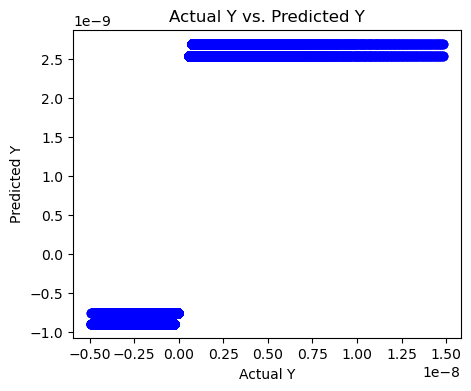

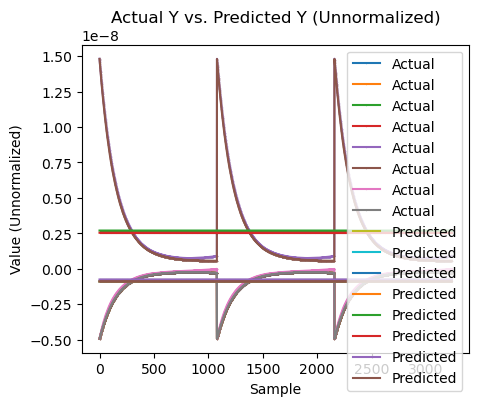

In [12]:
def predict(parameters, X):
    AL, _ = L_model_forward(X, parameters)
    return AL

prediction,p2 = L_model_forward(X_norm.T,p)
print(pd.DataFrame(prediction.T).shape)
Y_pred_randomized = pd.DataFrame(prediction.T)
Y_pred_randomized_wo_drop = Y_pred_randomized.assign(OriginalIndex= idx)
Y_pred_unrandomized_wo_drop = Y_pred_randomized_wo_drop.sort_values(by='OriginalIndex')
Y_pred_unrandomized_dropped = Y_pred_unrandomized_wo_drop.drop(columns=['OriginalIndex'])
Y_normalized = normalize_mat(np.array(Y))
print(Y_pred_unrandomized_dropped.shape)
print(Y_normalized.shape)
# Scatter plot
plt.scatter(Y_normalized, np.array(Y_pred_unrandomized_dropped), color='blue')
plt.xlabel('Actual Y')
plt.ylabel('Predicted Y')
plt.title('Actual Y vs. Predicted Y')
plt.show()
# Alternatively, you can use a line plot for a visual comparison
plt.plot(Y_normalized, label='Actual', marker='o', markersize=.1)
plt.plot(np.array(Y_pred_unrandomized_dropped), label='Predicted', marker='x',markersize=.1)
plt.xlabel('Sample')
plt.ylabel('Value (Unnormalized)')
plt.title('Actual Y vs. Predicted Y (Unnormalized)')
plt.legend()
plt.show()